In [80]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [81]:
path = "/content/drive/MyDrive/CV/Project/middlebury_dataset/"

In [82]:
import os
import cv2
import numpy as np
import pickle

In [83]:
from google.colab.patches import cv2_imshow

In [84]:
with open(path + 'depth.pickle', 'rb') as file:
    data1 = pickle.load(file)

data1[0]

array([[232, 232, 231, ...,  50,  50,  50],
       [232, 232, 231, ...,  50,  50,  50],
       [232, 232, 231, ...,  50,  50,  50],
       ...,
       [255, 255, 255, ..., 105, 105, 105],
       [255, 255, 255, ..., 105, 105, 255],
       [255, 255, 255, ..., 105, 255, 255]], dtype=uint8)

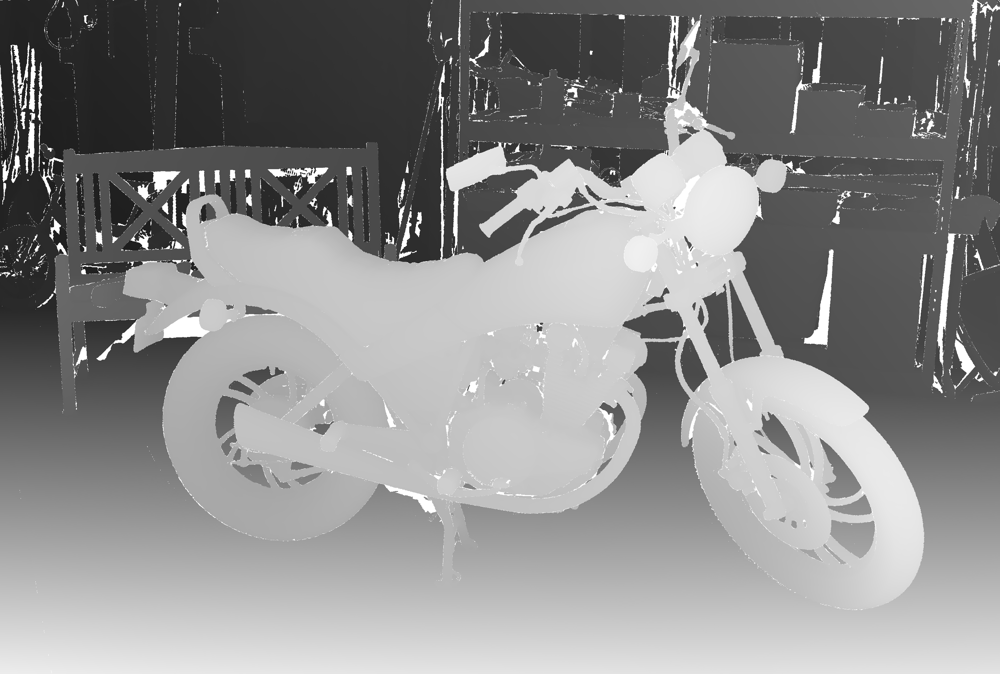

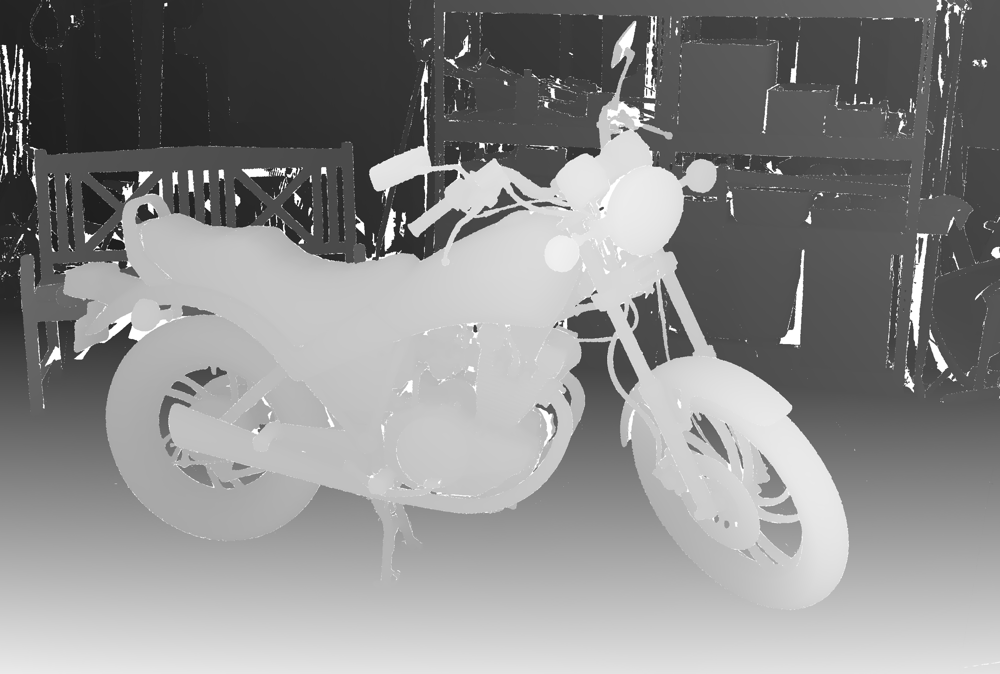

In [85]:
cv2_imshow(data1[6])
cv2_imshow(data1[7])

In [86]:
with open(path + 'gray.pickle', 'rb') as file:
    data2 = pickle.load(file)

data2[0]

array([[ 83,  83,  83, ..., 192, 191, 190],
       [ 83,  83,  83, ..., 192, 191, 190],
       [ 83,  82,  83, ..., 193, 191, 190],
       ...,
       [241, 242, 242, ...,  11,  12,  13],
       [241, 241, 242, ...,  11,  12,  13],
       [240, 241, 241, ...,  12,  12,  12]], dtype=uint8)

In [87]:
with open(path + 'txt.pickle', 'rb') as file:
    data3 = pickle.load(file)

data3[0]

'cam0=[7242.753 0 1079.538; 0 7242.753 1018.846; 0 0 1]\ncam1=[7242.753 0 1588.865; 0 7242.753 1018.846; 0 0 1]\ndoffs=509.327\nbaseline=379.965\nwidth=2356\nheight=1996\nndisp=1110\nisint=0\nvmin=7\nvmax=1100\ndyavg=0\ndymax=0\n'

In [88]:
# with open(path + 'gt_depth.pickle', 'rb') as file:
#     gt_depth = pickle.load(file)

In [89]:
def param_find(arr):
    p1 = (arr[0][arr[0].find('=')+2  :len(arr[0])-1]).split(';')
    cam0 = []
    for pr in p1:
        cam0.append(list(map(float,pr.split())))
    p2 = (arr[1][arr[1].find('=')+2  :len(arr[1])-1]).split(';')
    cam1 = []
    for pr in p2:
        cam1.append(list(map(float,pr.split())))
    doffs = float(arr[2][arr[2].find('=')+1 : len(arr[2])])
    baseline = float(arr[3][arr[3].find('=')+1 : len(arr[3])])
    width = float(arr[4][arr[4].find('=')+1 : len(arr[4])])
    height = float(arr[5][arr[5].find('=')+1 : len(arr[5])])
    ndisp = float(arr[6][arr[6].find('=')+1 : len(arr[6])])
    isint = float(arr[7][arr[7].find('=')+1 : len(arr[7])])
    vmin = float(arr[8][arr[8].find('=')+1 : len(arr[8])])
    vmax = float(arr[9][arr[9].find('=')+1 : len(arr[9])])
    dyavg = float(arr[10][arr[10].find('=')+1 : len(arr[10])])
    dymax = float(arr[11][arr[11].find('=')+1 : len(arr[11])])
    return np.array(cam0), np.array(cam1), doffs,baseline, width, height

In [90]:
len(data1), len(data2), len(data3)

(46, 46, 23)

In [91]:
cam0,cam1, doffs,baseline, width, height = param_find(data3[3].split('\n'))

In [92]:
img1 = data2[6]
img2 = data2[7]

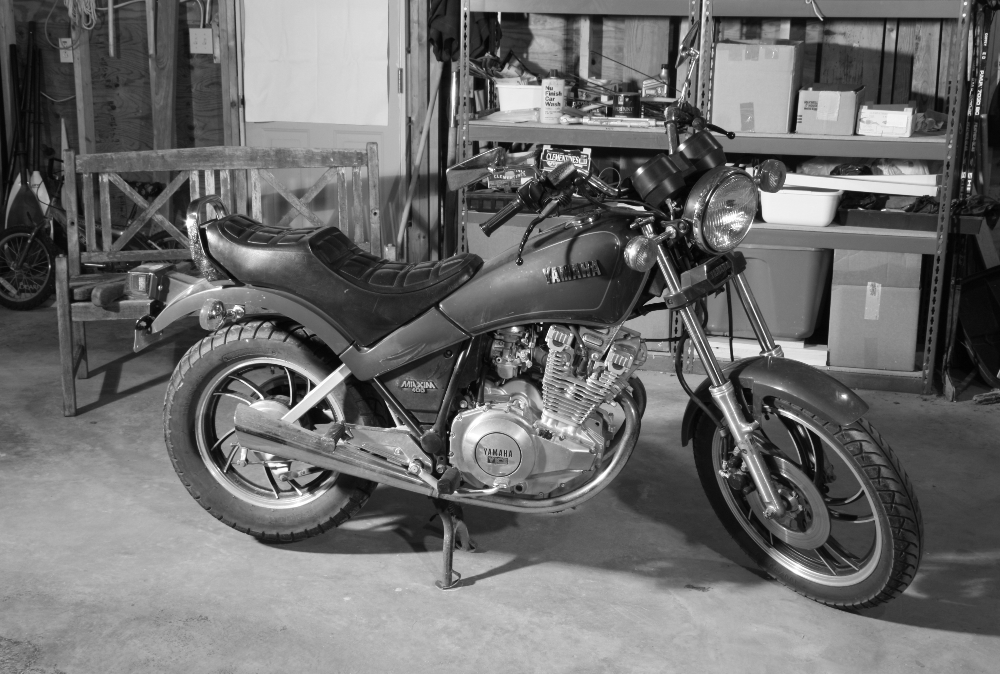

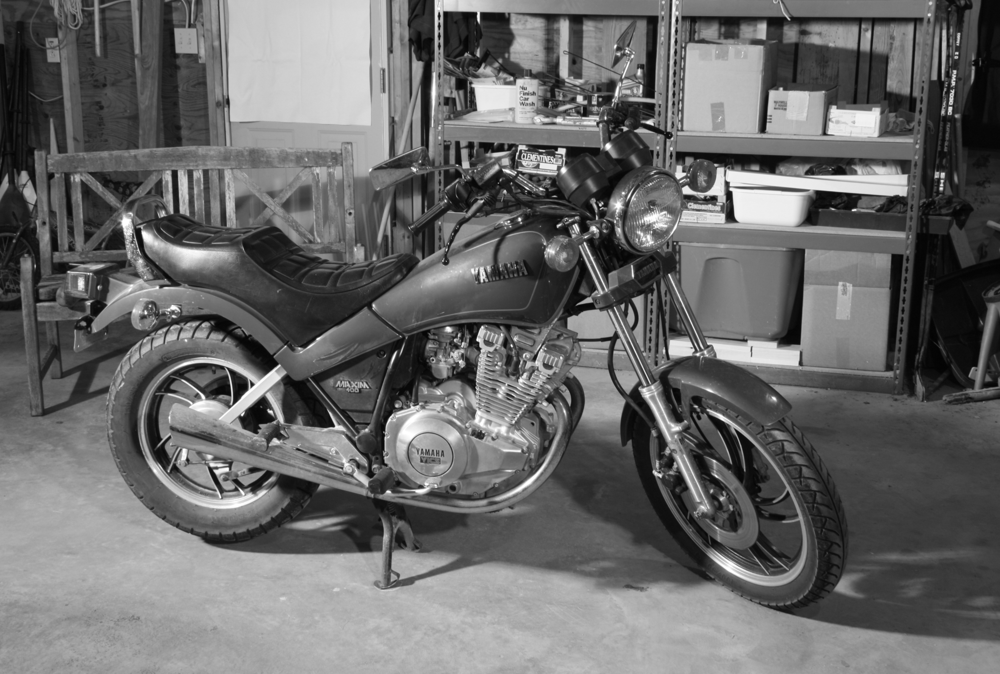

In [93]:
cv2_imshow(img1)
cv2_imshow(img2)

In [94]:
image0_gray = data2[2]
image1_gray = data2[3]

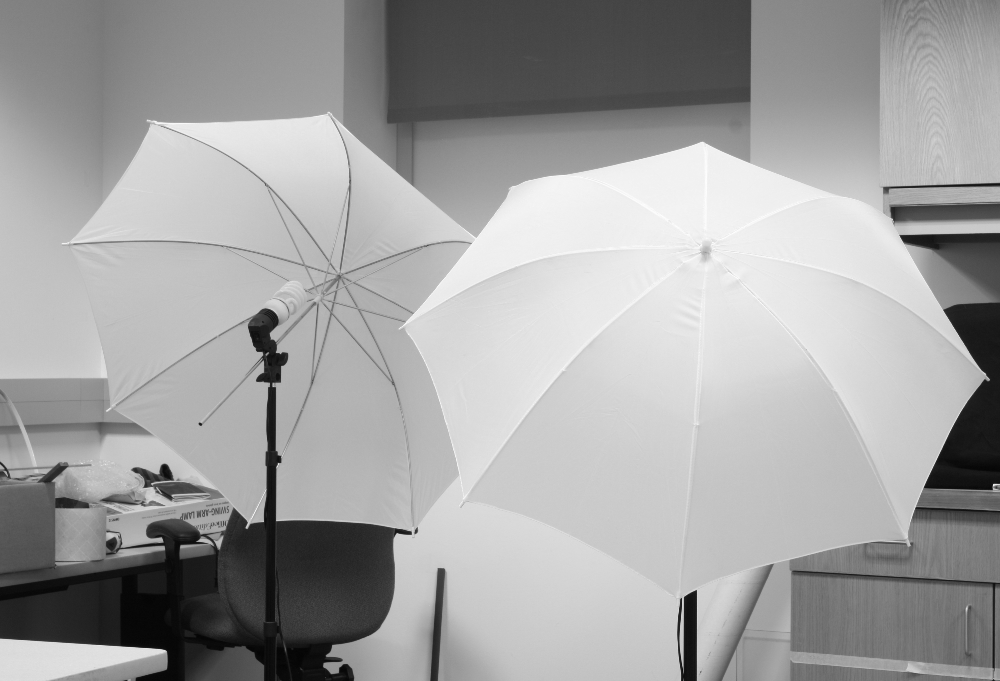

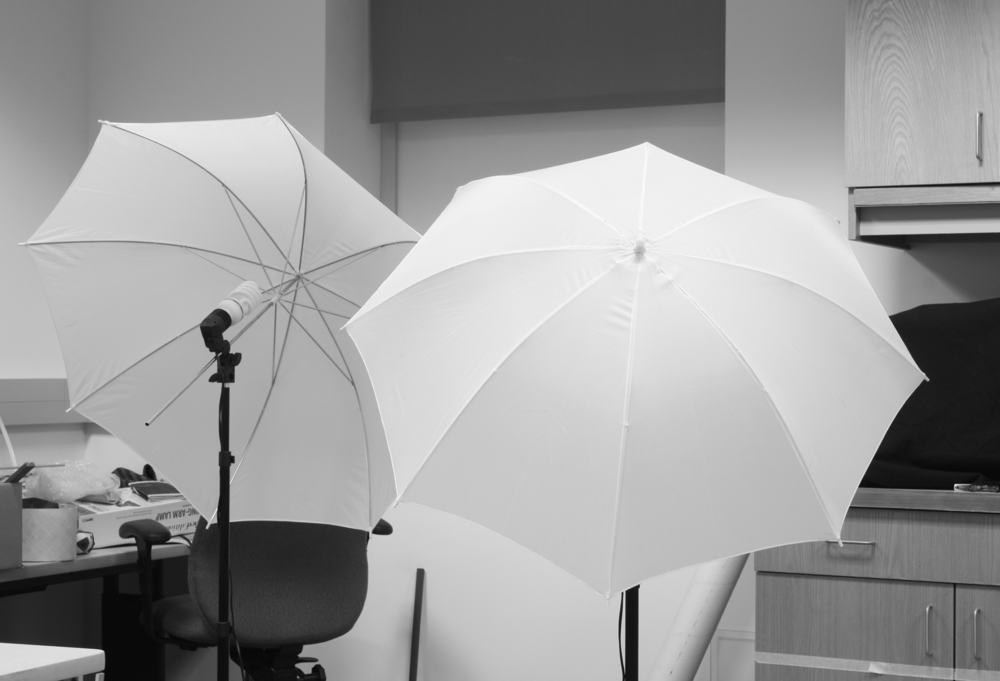

In [95]:
cv2_imshow(image0_gray)
cv2_imshow(image1_gray)

Finding matches

Matches Found and sorted



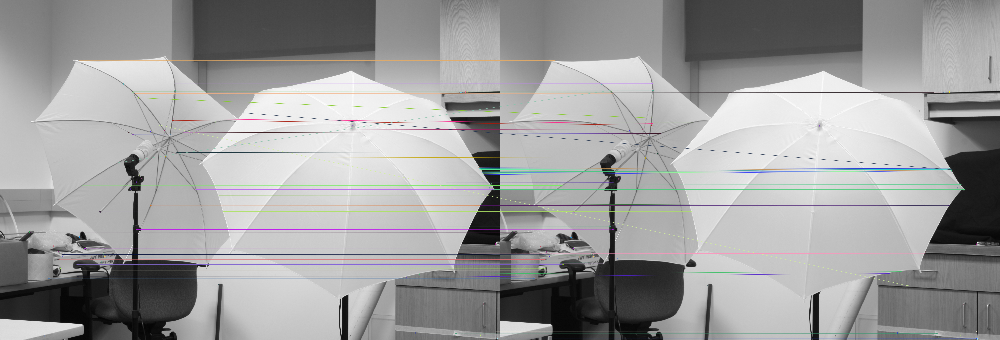

In [96]:
print("Finding matches\n")
sift = cv2.SIFT_create()
kp1, des1 = sift.detectAndCompute(image0_gray, None)
kp2, des2 = sift.detectAndCompute(image1_gray, None)
bf = cv2.BFMatcher()
matches = bf.match(des1,des2)
matches = sorted(matches, key = lambda x :x.distance)
chosen_matches = matches[0:100]

print("Matches Found and sorted\n")

matched_image = cv2.drawMatches(image0_gray,kp1,image1_gray,kp2,matches[:100],None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
cv2_imshow(matched_image)

In [97]:
def SIFT_features_as_array(sift_matches, kp1, kp2):
    matching_pairs = []
    for i, m1 in enumerate(sift_matches):
        pts_1 = kp1[m1.queryIdx].pt
        pts_2 = kp2[m1.trainIdx].pt
        matching_pairs.append([pts_1[0], pts_1[1], pts_2[0], pts_2[1]])
        array_pair = np.array(matching_pairs).reshape(-1, 4)
    matching_pairs = array_pair
    return matching_pairs

In [98]:
matched_pairs = SIFT_features_as_array(chosen_matches, kp1, kp2)

In [99]:
def func_normalize_val(xy):

    xy_new = np.mean(xy, axis=0)
    x_new ,y_dash = xy_new[0], xy_new[1]

    x_hat = xy[:,0] - x_new
    y_hat = xy[:,1] - y_dash

    dist = np.mean(np.sqrt(x_hat**2 + y_hat**2))
    s = (2/dist)

    scaling = np.diag([s,s,1])
    T_trans = np.array([[1,0,-x_new],[0,1,-y_dash],[0,0,1]])
    T = scaling.dot(T_trans)

    x_ = np.column_stack((xy, np.ones(len(xy))))
    x_norm = (T.dot(x_.T)).T

    return  x_norm, T

In [100]:
def Compute_Fundamental_Matrix(feature_matches):

    normalised = True
    thresh_val = 7

    x1 = feature_matches[:,0:2]
    x2 = feature_matches[:,2:4]

    if x1.shape[0] > thresh_val:
        if normalised == True:
            x1_norm, T1 = func_normalize_val(x1)
            x2_norm, T2 = func_normalize_val(x2)
        else:
            x1_norm,x2_norm = x1,x2

        A = np.zeros((len(x1_norm),9))
        for i in range(0, len(x1_norm)):
            x_1,y_1 = x1_norm[i][0], x1_norm[i][1]
            x_2,y_2 = x2_norm[i][0], x2_norm[i][1]
            A[i] = np.array([x_1*x_2, x_2*y_1, x_2, y_2*x_1, y_2*y_1, y_2, x_1, y_1, 1])

        U, S, VT = np.linalg.svd(A, full_matrices=True)
        F = VT.T[:, -1]
        F = F.reshape(3,3)

        u, s, vt = np.linalg.svd(F)
        s = np.diag(s)
        s[2,2] = 0
        F = np.dot(u, np.dot(s, vt))

        if normalised:
            F = np.dot(T2.T, np.dot(F, T1))
        return F

    else:
        return None

In [101]:
def epipolar_constraint(feature, F):
    x1,x2 = feature[0:2], feature[2:4]
    x1tmp=np.array([x1[0], x1[1], 1]).T
    x2tmp=np.array([x2[0], x2[1], 1])

    error = np.dot(x1tmp, np.dot(F, x2tmp))

    return np.abs(error)

In [102]:
def RANSAC(features):
    iterations = 1000
    threshold_val = 0.02
    inliers_thresh = 0
    best_fit_pts = []
    fundamental_mat = 0

    for i in range(0, iterations):
        indices = []
        n_rows = features.shape[0]
        random_indices = np.random.choice(n_rows, size=8)
        best_correspondences = features[random_indices, :]
        f_8 = Compute_Fundamental_Matrix(best_correspondences)
        for j in range(n_rows):
            feature = features[j]
            error = epipolar_constraint(feature, f_8)
            if error < threshold_val:
                indices.append(j)

        if len(indices) > inliers_thresh:
            inliers_thresh = len(indices)
            best_fit_pts = indices
            fundamental_mat = f_8

    required_features = features[best_fit_pts, :]
    return fundamental_mat, required_features

In [103]:
F_best, best_correspondoing_points = RANSAC(matched_pairs)

In [104]:
def compute_Essential_matrix(K1, K2, F):
    E = K2.T.dot(F).dot(K1)
    U,S,V = np.linalg.svd(E)
    #rank constraint
    S = [1,1,0]
    new_E = np.dot(U,np.dot(np.diag(S),V))
    return new_E

In [105]:
E = compute_Essential_matrix(cam0, cam1, F_best)

In [106]:
def Restore_cam_pose(E):
    U, S, V_T = np.linalg.svd(E)
    W = np.array([[0, -1, 0], [1, 0, 0], [0, 0, 1]])

    Rot = []
    trans = []
    Rot.append(np.dot(U, np.dot(W, V_T)))
    Rot.append(np.dot(U, np.dot(W, V_T)))
    Rot.append(np.dot(U, np.dot(W.T, V_T)))
    Rot.append(np.dot(U, np.dot(W.T, V_T)))

    trans.append(U[:, 2])
    trans.append(-U[:, 2])
    trans.append(U[:, 2])
    trans.append(-U[:, 2])
    for i in range(4):
        if (np.linalg.det(Rot[i]) < 0):
            Rot[i] = -Rot[i]
            trans[i] = -trans[i]

    return Rot, trans


In [107]:
R2_, C2_ = Restore_cam_pose(E)

Pts_3D = []
R1  = np.identity(3)
C1  = np.zeros((3, 1))
I = np.identity(3)

In [108]:
for i in range(len(R2_)):
    R2 =  R2_[i]
    C2 =   C2_[i].reshape(3,1)
    Proj_mat_im0 = np.dot(cam0, np.dot(R1, np.hstack((I, -C1.reshape(3,1)))))
    Proj_mat_im1 = np.dot(cam1, np.dot(R2, np.hstack((I, -C2.reshape(3,1)))))

    for x_left_img,x_right_img in zip(best_correspondoing_points[:,0:2], best_correspondoing_points[:,2:4]):
        pts_3d = cv2.triangulatePoints(Proj_mat_im0, Proj_mat_im1, np.float32(x_left_img), np.float32(x_right_img))
        pts_3d = np.array(pts_3d)
        pts_3d = pts_3d[0:3,0]
        Pts_3D.append(pts_3d)

In [109]:
def check_cheirality(pts_3D,trans,Rot):
    best_pts = 0
    for P in pts_3D:
        P = P.reshape(-1,1)
        if Rot.dot(P - trans) > 0 and P[2]>0:
            best_pts+=1
    return best_pts

In [110]:
best_indices = 0
max_Positive = 0

for i in range(len(R2_)):
    R_, C_ = R2_[i],  C2_[i].reshape(-1,1)
    R_3 = R_[2].reshape(1,-1)
    num_Positive = check_cheirality(Pts_3D,C_,R_3)

    if num_Positive > max_Positive:
        best_indices = i
        max_Positive = num_Positive

In [111]:
Rotation_coniguration, Translation_coniguration, P3D = R2_[best_indices], C2_[best_indices], Pts_3D[best_indices]

print(" Camera Pose: (Rotation) \n",Rotation_coniguration,'\n')
print(" Camera Pose: (Translation) \n", Translation_coniguration, '\n')

 Camera Pose: (Rotation) 
 [[ 0.99999442 -0.00111754 -0.00314947]
 [ 0.00112678  0.99999506  0.00293269]
 [ 0.00314618 -0.00293622  0.99999074]] 

 Camera Pose: (Translation) 
 [-0.99790195 -0.01870646 -0.06198205] 



In [112]:
R1, R2, P1, P2, Q, validPixROI1, validPixROI2 = cv2.stereoRectify(cam0, None, cam1, None, image0_gray.shape[::-1], Rotation_coniguration, Translation_coniguration, alpha=0)

In [113]:
map1_left, map2_left = cv2.initUndistortRectifyMap(cam0, None, R1, P1, image0_gray.shape[::-1], cv2.CV_32FC1)
map1_right, map2_right = cv2.initUndistortRectifyMap(cam1, None, R2, P2, image1_gray.shape[::-1], cv2.CV_32FC1)

img_left_gray_rect = cv2.remap(image0_gray, map1_left, map2_left, cv2.INTER_LINEAR)
img_right_gray_rect = cv2.remap(image1_gray, map1_right, map2_right, cv2.INTER_LINEAR)

In [114]:
img_rect_left = img_left_gray_rect.astype(int)
img_rect_right = img_right_gray_rect.astype(int)

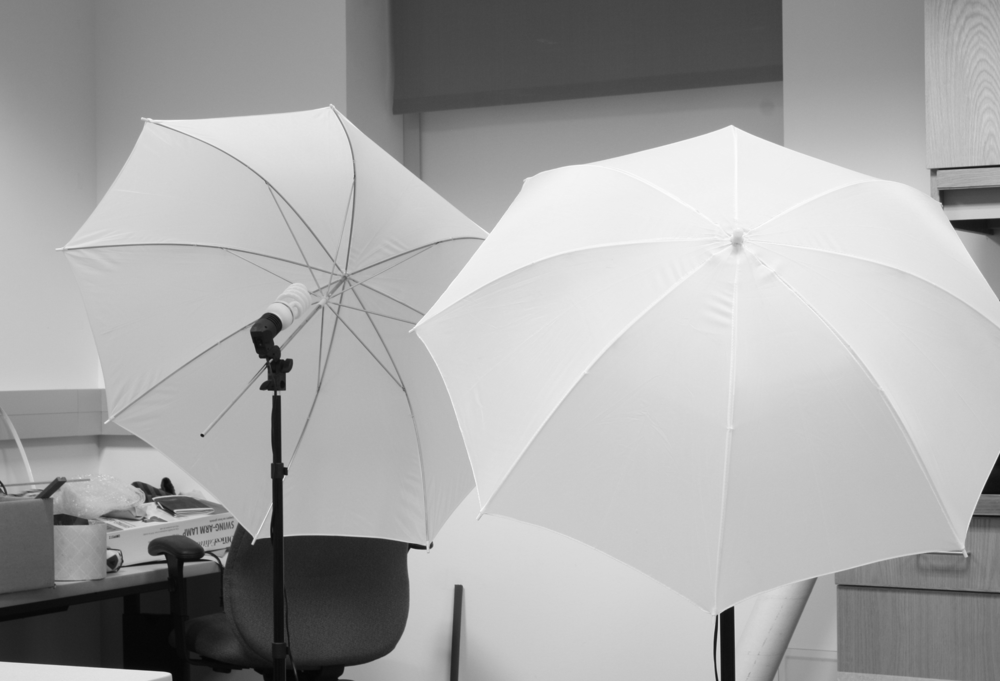

In [115]:
cv2_imshow(img_rect_left)

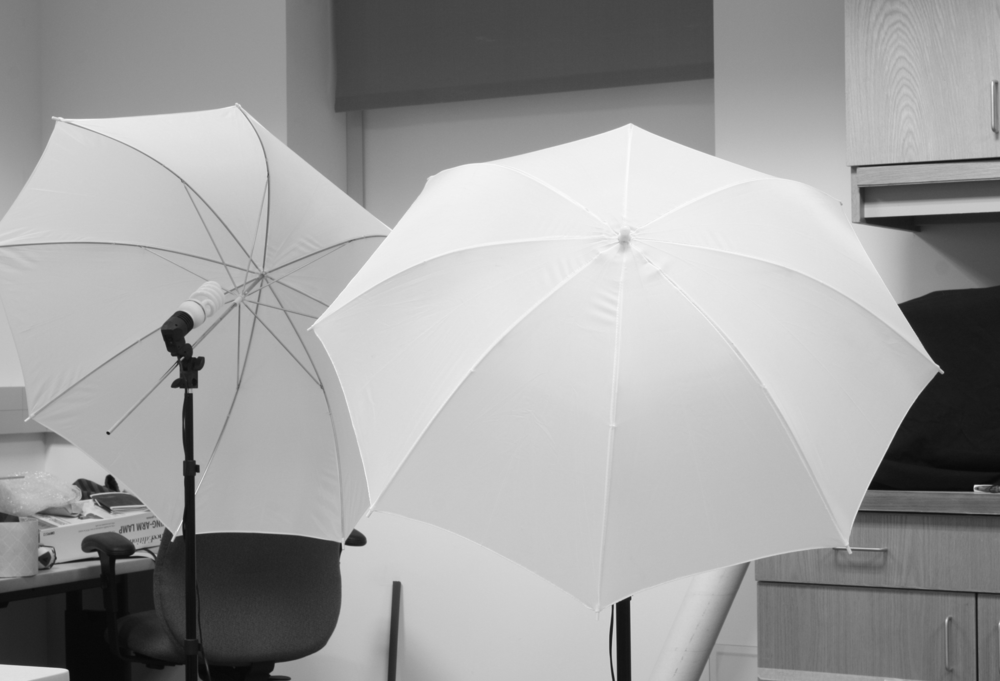

In [116]:
cv2_imshow(img_rect_right)

In [117]:
height, width = img_rect_left.shape
disparity_map = np.zeros((height, width))
window = 5
x_new = width - (2 * window)

In [118]:
from tqdm import tqdm

In [ ]:
for y in tqdm(range(window, height-window)):

    block_img_rect_left = []
    block_img_rect_right = []
    for x in range(window, width-window):
        block_left = img_rect_left[y:y + window, x:x + window]
        block_img_rect_left.append(block_left.flatten())

        block_right = img_rect_right[y:y + window, x:x + window]
        block_img_rect_right.append(block_right.flatten())

    block_img_rect_left = np.array(block_img_rect_left)
    block_img_rect_right = np.array(block_img_rect_right)

    block_img_rect_left = np.repeat(block_img_rect_left[:, :, np.newaxis], x_new, axis=2)
    block_img_rect_right = np.repeat(block_img_rect_right[:, :, np.newaxis], x_new, axis=2)


    block_img_rect_right = block_img_rect_right.T

    ###----Sum of Absolute Differences (SAD)----###
    absolute_difference = np.abs(block_img_rect_left - block_img_rect_right)
    SAD = np.sum(absolute_difference, axis = 1)
    index = np.argmin(SAD, axis = 0)
    disparity = np.abs(index - np.linspace(0, x_new, x_new, dtype=int)).reshape(1, x_new)
    disparity_map[y, 0:x_new] = disparity

  2%|▏         | 48/2006 [06:53<4:48:44,  8.85s/it]

In [ ]:
disparity_map_int = np.uint8(disparity_map * 255 / np.max(disparity_map))

In [ ]:
import matplotlib.pyplot as plt

In [ ]:
plt.imshow(disparity_map_int, cmap='hot', interpolation='nearest')

In [ ]:
plt.imshow(disparity_map_int, cmap='gray', interpolation='nearest')
plt.show()

In [ ]:
depth_thresh = 100000
f = cam0[0][0]

In [ ]:
depth = (baseline * f) / (disparity_map + 1e-10)
depth[depth > depth_thresh] = depth_thresh
depth_map = np.uint8(depth * 255 / np.max(depth))

In [ ]:
plt.imshow(depth_map, cmap='hot', interpolation='nearest')

In [ ]:
plt.imshow(depth_map, cmap='gray', interpolation='nearest')
plt.show()

In [ ]:
# mae = np.mean(np.abs(gt_depth - depth_map))
# print('MAE: ', mae)